<a href="https://colab.research.google.com/github/rastringer/vertex-ai-examples/blob/main/all_about_imagen.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install requests google-auth google-cloud-aiplatform


# Imagen

The latest version of Imagen is 3, and 3 Fast for images generated with near quality to the principal version, with speedier generation.

Imagen3 is currently available via private preview requiring project allowlisting. This makes an API accessible, UI and SDK availability will follow in the short term.

Some features available in earlier model versions are not yet present in the newer models. Please see the [docs](https://cloud.google.com/vertex-ai/generative-ai/docs/image/overview) for current availability of the various models.

### Import libraries and authenticate

In [6]:
import vertexai
from vertexai.preview.vision_models import Image, ImageGenerationModel
import io
import subprocess
import requests
import base64
from IPython.display import Image, display
from PIL import Image as PILImage
from google.colab import auth

auth.authenticate_user()


### Image imports

Let's import an image from Cloud Storage

In [48]:
!wget https://quantis.com/wp-content/uploads/2022/05/fashion-circularity-reuse.jpg -O fashion_image.jpg

--2024-11-25 12:09:18--  https://quantis.com/wp-content/uploads/2022/05/fashion-circularity-reuse.jpg
Resolving quantis.com (quantis.com)... 185.181.161.229
Connecting to quantis.com (quantis.com)|185.181.161.229|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 418429 (409K) [image/jpeg]
Saving to: ‘fashion_image.jpg’

fashion_image.jpg   100%[===================>] 408.62K   537KB/s    in 0.8s    

2024-11-25 12:09:19 (537 KB/s) - ‘fashion_image.jpg’ saved [418429/418429]



### Display the original image

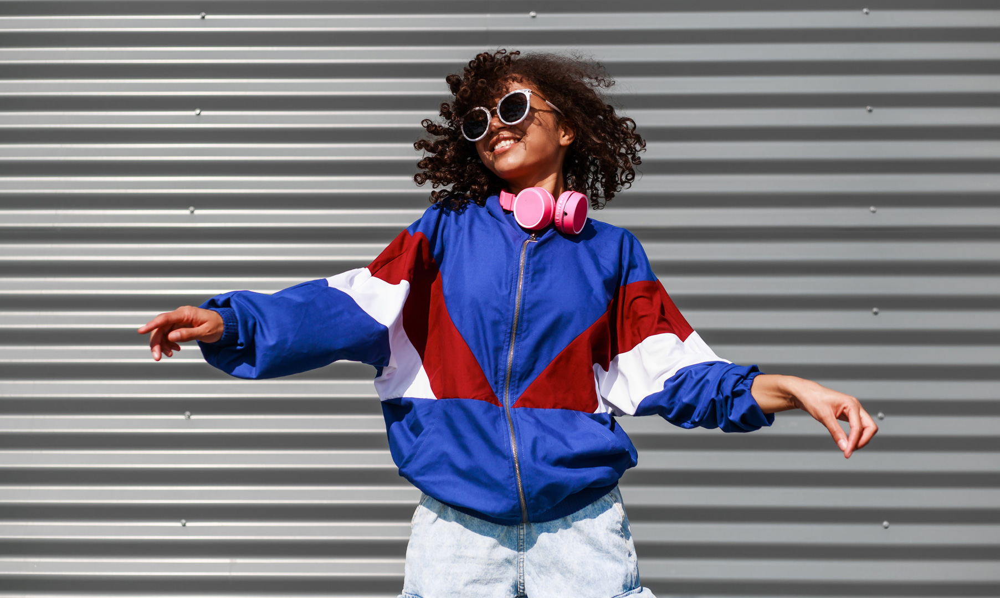

In [58]:
image_path = 'fashion_image.jpg'
image = PILImage.open(image_path)
from IPython.display import Image, display
display(Image(image_path))

### Authentication

To authenticate the API calls, we will use the access token generated by `gcloud`

In [36]:
def get_access_token():
    cmd = 'gcloud auth print-access-token'
    access_token = subprocess.check_output(cmd, shell=True).decode('utf-8').strip()
    return access_token

### Environment variables

In [59]:
LOCATION = 'us-central1'  # Project region
PROJECT_ID = '<your-project-id>'  # Project ID
UPSCALE_FACTOR = 'x2'  # 'x2' or 'x4'
INPUT_IMAGE_PATH = 'fashion_image.jpg'  # Path to input image
MODEL_NAME = 'imagen-3.0-generate-001'  # Latest

vertexai.init(project=PROJECT_ID, location="us-central1")

### Image Upscaling

We can make an image larger without losing its quality. This feature is available via API (not SDK) from the original Imagen model.

In [95]:
IMAGE_INPUT_PATH = 'tiny_image.jpg'
def image_to_b64(image_path):
  # Read and base64 encode image
  with open(INPUT_IMAGE_PATH, 'rb') as image_file:
      image_bytes = image_file.read()
      b64_image = base64.b64encode(image_bytes).decode('utf-8')
      return b64_image

image_to_b64(INPUT_IMAGE_PATH)

'/9j/4QAYRXhpZgAASUkqAAgAAAAAAAAAAAAAAP/sABFEdWNreQABAAQAAABQAAD/4QRtaHR0cDovL25zLmFkb2JlLmNvbS94YXAvMS4wLwA8P3hwYWNrZXQgYmVnaW49Iu+7vyIgaWQ9Ilc1TTBNcENlaGlIenJlU3pOVGN6a2M5ZCI/PiA8eDp4bXBtZXRhIHhtbG5zOng9ImFkb2JlOm5zOm1ldGEvIiB4OnhtcHRrPSJBZG9iZSBYTVAgQ29yZSA3LjEtYzAwMCA3OS5lZGEyYjNmYWMsIDIwMjEvMTEvMTctMTc6MjM6MTkgICAgICAgICI+IDxyZGY6UkRGIHhtbG5zOnJkZj0iaHR0cDovL3d3dy53My5vcmcvMTk5OS8wMi8yMi1yZGYtc3ludGF4LW5zIyI+IDxyZGY6RGVzY3JpcHRpb24gcmRmOmFib3V0PSIiIHhtbG5zOnhtcE1NPSJodHRwOi8vbnMuYWRvYmUuY29tL3hhcC8xLjAvbW0vIiB4bWxuczpzdFJlZj0iaHR0cDovL25zLmFkb2JlLmNvbS94YXAvMS4wL3NUeXBlL1Jlc291cmNlUmVmIyIgeG1sbnM6eG1wPSJodHRwOi8vbnMuYWRvYmUuY29tL3hhcC8xLjAvIiB4bWxuczpkYz0iaHR0cDovL3B1cmwub3JnL2RjL2VsZW1lbnRzLzEuMS8iIHhtcE1NOk9yaWdpbmFsRG9jdW1lbnRJRD0iNUI5QjdCREIyRUNBRjA2NUNFRjU2RjFEOUNERDU5MEQiIHhtcE1NOkRvY3VtZW50SUQ9InhtcC5kaWQ6RThFNzY3N0FDREVGMTFFQ0I2OTlGRDFGOTQ4RjlDNDkiIHhtcE1NOkluc3RhbmNlSUQ9InhtcC5paWQ6RThFNzY3NzlDREVGMTFFQ0I2OTlGRDFGOTQ4RjlDNDkiIHhtcDpDcmVhdG9yVG9vbD0iQWRvYmUgUGhvdG9zaG9wIEN

In [96]:
import requests
import base64
from typing import Optional
from IPython.display import Image as IPythonImage
from pathlib import Path

def upscale_image_api(
    b64_image: str,
    project_id: str,
    location: str,
    model_name: str,
    upscale_factor: int = 2,
    output_path: Optional[str] = 'upscaled_image.png',
    get_access_token=None  # Pass your access token function
) -> Optional[bytes]:

    try:
        # Prepare request body
        request_body = {
            "instances": [{
                "prompt": "",
                "image": {
                    "bytesBase64Encoded": b64_image
                }
            }],
            "parameters": {
                "sampleCount": 1,
                "mode": "upscale",
                "upscaleConfig": {
                    "upscaleFactor": upscale_factor
                }
            }
        }

        # Get authentication and prepare headers
        access_token = get_access_token()
        if not access_token:
            raise ValueError("Failed to get access token")

        headers = {
            'Authorization': f'Bearer {access_token}',
            'Content-Type': 'application/json; charset=utf-8'
        }

        # Prepare API URL
        url = (f'https://{location}-aiplatform.googleapis.com/v1/projects/'
               f'{project_id}/locations/{location}/publishers/google/models/{model_name}:predict')

        # Make API request
        response = requests.post(url, headers=headers, json=request_body)

        # Handle response
        if response.status_code == 200:
            response_json = response.json()
            upscaled_image_b64 = response_json['predictions'][0]['bytesBase64Encoded']
            upscaled_image_bytes = base64.b64decode(upscaled_image_b64)

            # Save image if path provided
            if output_path:
                Path(output_path).write_bytes(upscaled_image_bytes)
                print(f"Upscaled image saved as '{output_path}'")

            # Display the image in notebook
            display(IPythonImage(upscaled_image_bytes))

            return upscaled_image_bytes

        else:
            print(f"API Error: {response.status_code}")
            print(f"Response: {response.text}")
            return None

    except Exception as e:
        print(f"Error during upscaling: {str(e)}")
        return None

Upscaled image saved as 'upscaled_image.png'


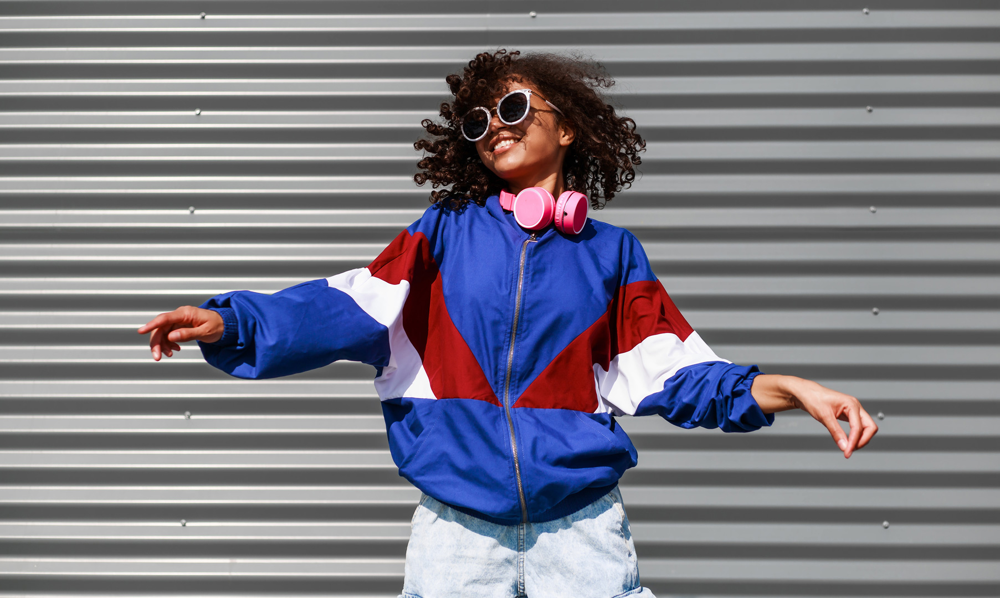

Image upscaling successful!


In [97]:
# Example usage
result = upscale_image_api(
    b64_image=b64_image,
    project_id=PROJECT_ID,
    location='us-central1',
    model_name=MODEL_NAME,
    upscale_factor="x2",
    output_path='upscaled_image.png',
    get_access_token=get_access_token  # Your token function
)

if result is not None:
    print("Image upscaling successful!")

### Limitations

Images can be resized by X 2 or X 4 larger. We can use traditional Python libraries such as Pillow should we need to make images both smaller and larger.

Let's check the size of our original image.

In [63]:
print(image.size)

(1805, 1080)


### Making images smaller while preserving aspect ratio

Pillow's `thumbnail` method accomplishes this, and can only be used to make images smaller, not larger.

Original size: (1805, 1080)


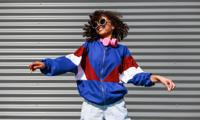

New size: (200, 120)


In [64]:
image = PILImage.open(image_path)
print(f"Original size: {image.size}")
image.thumbnail((200, 200))
image.save('tiny_image.jpg')
display(Image('tiny_image.jpg'))
print(f"New size: {image.size}")

### Enlarging images with Python libraries

To make an image larger while preserving the aspect ratio, we can use the dimensions of an image to calculate its scaling ratio based on the target enlarged size.

In [82]:
from PIL import Image
from IPython.display import display, Image as IPythonImage
from typing import Tuple, Union
import os

def resize_image(
    image_path: str,
    target_size: Union[int, Tuple[int, int]] = 2000,
    save_path: str = None,
    show_image: bool = True
) -> Image.Image:

    # Open the image
    image = Image.open(image_path)
    print(f"Original size: {image.size}")

    # Handle target size
    original_width, original_height = image.size
    if isinstance(target_size, tuple):
        target_width, target_height = target_size
        ratio = max(target_width/original_width, target_height/original_height)
    else:
        # If single number provided, use it as target for largest dimension
        ratio = target_size / max(original_width, original_height)

    # Calculate new dimensions
    new_size = (int(original_width * ratio), int(original_height * ratio))

    # Resize image
    resized_image = image.resize(new_size, Image.Resampling.LANCZOS)
    print(f"New size: {resized_image.size}")

    # Save if requested
    if save_path is None:
        base, ext = os.path.splitext(image_path)
        save_path = f"{base}_resized{ext}"

    resized_image.save(save_path)
    print(f"Saved resized image to: {save_path}")

    # Display if requested
    if show_image:
        display(IPythonImage(save_path))

    return resized_image

Original size: (1805, 1080)
New size: (200, 119)
Saved resized image to: tiny_image.jpg


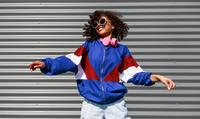

In [84]:
# Specify a target size and custom save path
resized = resize_image(
    image_path,
    target_size=200,
    save_path='tiny_image.jpg'
)


### Benefits of generative models for resizing

One strength of generative models is that they can help preserve image quality, particularly when going from a small to much larger image. Using Python libraries, we notice the loss of quality when going from a thumbnail to large image:

Original size: (200, 120)
New size: (2000, 1200)
Saved resized image to: larger_image.jpg


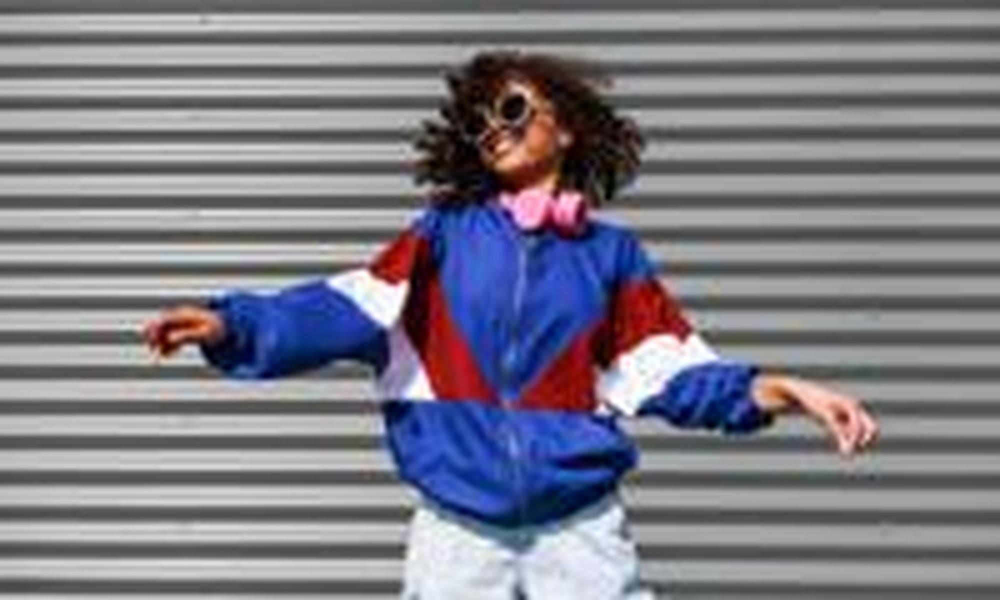

In [83]:
# Specify a target size and custom save path
resized = resize_image(
    'tiny_image.jpg',
    target_size=2000,
    save_path='larger_image.jpg'
)

Contrast this approach to using Imagen to go from thumbnail to x2

Upscaled image saved as 'upscaled_image.png'


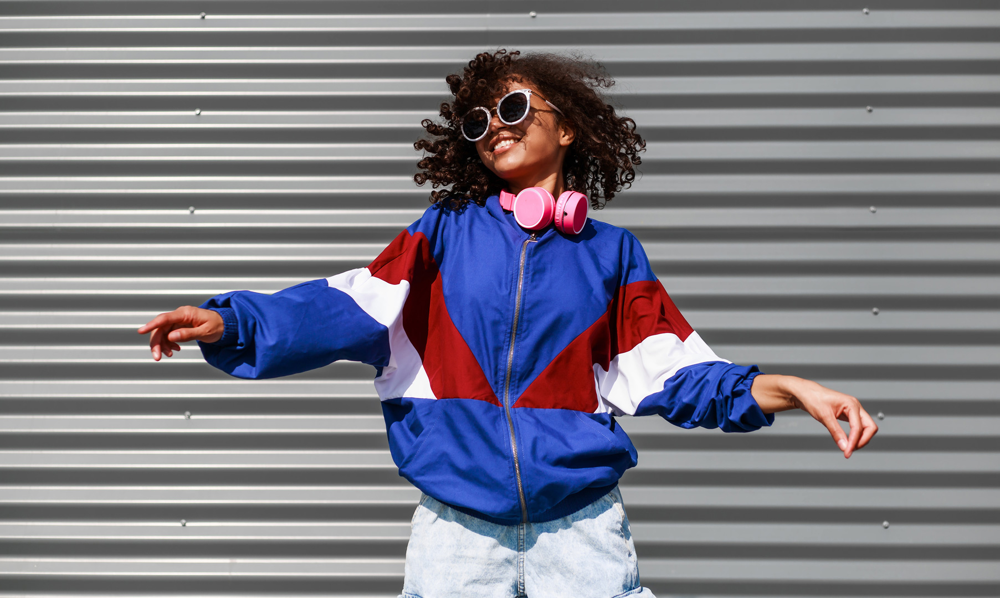

Image upscaling successful!


In [98]:
image_ = image_to_b64('tiny_image.jpg')

result = upscale_image_api(
    b64_image=image_,
    project_id=PROJECT_ID,
    location='us-central1',
    model_name=MODEL_NAME,
    upscale_factor="x2",
    output_path='upscaled_image.png',
    get_access_token=get_access_token  # Your token function
)

if result is not None:
    print("Image upscaling successful!")

### Editing images

Imagen offers several approaches to editing images, with or without providing a mask of the area which requires adjustments. Let's use Imagen2 to adjust the background in an image.

In [9]:
# Helper function for image resizing and display
from IPython.display import Image as IPyImage

def resize_display(image, width=500, height=500):
  pil_image = PILImage.open(io.BytesIO(image._image_bytes))
  resized_image = pil_image.resize((width, height))
  resized_image.save("resized_output.png") # Save the resized image
  display(resized_image)

In [74]:
!wget "https://www.travelandleisure.com/thmb/Ps_bHaCx61-Aocv0XOYSKHBMCok=/750x0/filters:no_upscale():max_bytes(150000):strip_icc():format(webp)/tal-product-mz-wallace-medium-metro-deluxe-tote-jjuliao-0085.jpg-e0a229dafb9447a18e46608165d472c9.jpg" -O handbag.jpeg

--2024-11-25 12:19:34--  https://www.travelandleisure.com/thmb/Ps_bHaCx61-Aocv0XOYSKHBMCok=/750x0/filters:no_upscale():max_bytes(150000):strip_icc():format(webp)/tal-product-mz-wallace-medium-metro-deluxe-tote-jjuliao-0085.jpg-e0a229dafb9447a18e46608165d472c9.jpg
Resolving www.travelandleisure.com (www.travelandleisure.com)... 151.101.2.137, 151.101.66.137, 151.101.130.137, ...
Connecting to www.travelandleisure.com (www.travelandleisure.com)|151.101.2.137|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 66666 (65K) [image/webp]
Saving to: ‘handbag.jpeg’

handbag.jpeg        100%[===================>]  65.10K  --.-KB/s    in 0.01s   

2024-11-25 12:19:35 (4.52 MB/s) - ‘handbag.jpeg’ saved [66666/66666]



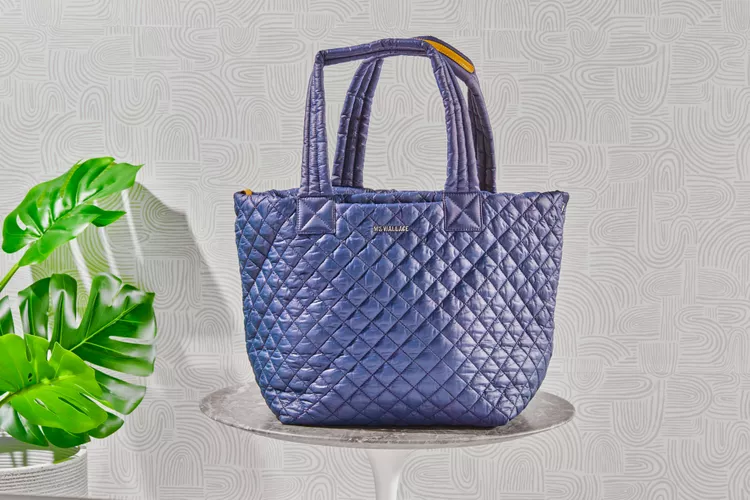

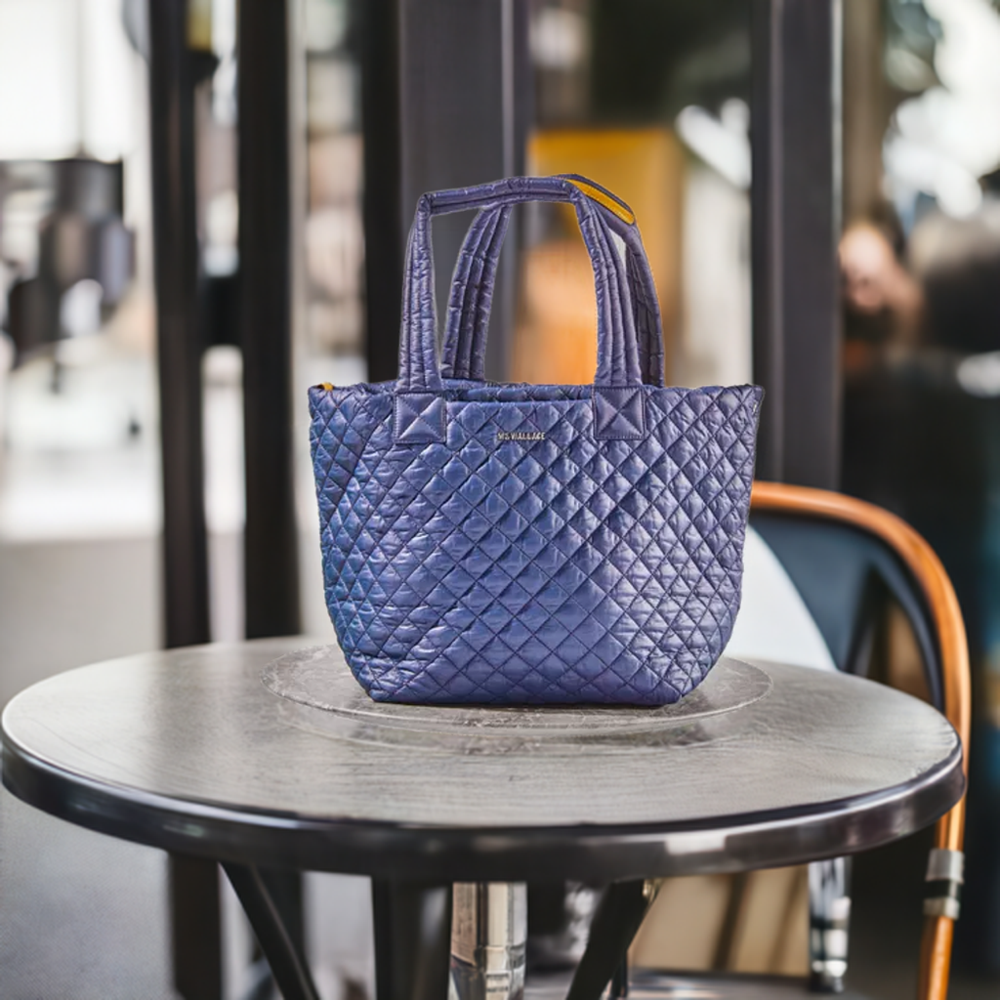

Created output image using 1032897 bytes


In [76]:
import vertexai
from vertexai.preview.vision_models import Image, ImageGenerationModel
from IPython.display import Image as IPImage, display

input_file = "handbag.jpeg"
output_file = "output_image.jpeg"
prompt = "Change the background to a table in a Parisian cafe"

model = ImageGenerationModel.from_pretrained("imagegeneration@006")
base_img = Image.load_from_file(location=input_file)

images = model.edit_image(
    base_image=base_img,
    prompt=prompt,
    edit_mode="product-image",
)

base_img.show()
images[0].save(location=output_file, include_generation_parameters=False)
images[0].show()

print(f"Created output image using {len(images[0]._image_bytes)} bytes")


### Extracting and translating text

Let's try Gemini's multimodal capabilities to extract the text from an image and provide a translation we could then add to the image using an editor.

We can be very prescriptive with Gemini using [controlled generation](https://cloud.google.com/vertex-ai/generative-ai/docs/multimodal/control-generated-output). We will specify that we need a json response of just the translated text.

## Text editing

Text inpainting can be difficult particulary when editing text already in an image (eg translating marketing text overlaid on a scene). We use Imagen2 in this example, things should improve with Imagen3 (this feature is not possible to demonstrate yet).


In [30]:
!wget https://www.wordstream.com/wp-content/uploads/2021/07/fashion-marketing-tips-brand-consistency.jpg -O text.jpg

--2024-11-25 11:25:16--  https://www.wordstream.com/wp-content/uploads/2021/07/fashion-marketing-tips-brand-consistency.jpg
Resolving www.wordstream.com (www.wordstream.com)... 104.18.10.50, 104.18.11.50, 2606:4700::6812:b32, ...
Connecting to www.wordstream.com (www.wordstream.com)|104.18.10.50|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 51579 (50K) [image/jpeg]
Saving to: ‘text.jpg’

text.jpg            100%[===================>]  50.37K  --.-KB/s    in 0.007s  

2024-11-25 11:25:17 (6.72 MB/s) - ‘text.jpg’ saved [51579/51579]



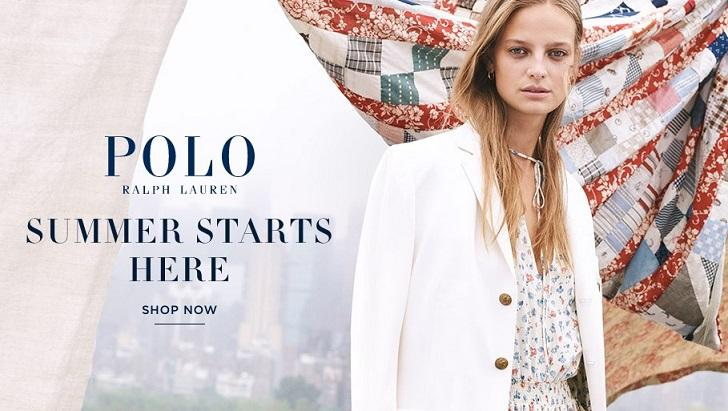

In [31]:
image_path = 'text.jpg'
image = PILImage.open(image_path)
from IPython.display import Image, display
display(Image(image_path))

In [32]:
# JSON schema for response
response_schema = {
  "type": "object",
  "properties": {
    "translatedText": {
      "type": "string"
    }
  },
  "required": [
    "translatedText"
  ]
}

In [33]:
import base64
import vertexai
from vertexai.generative_models import GenerativeModel, GenerationConfig, SafetySetting, Part
import os

def multiturn_generate_content(image_path):
    """Generates content from a local image using Vertex AI Gemini."""
    if not os.path.exists(image_path):
        raise FileNotFoundError(f"Image not found at path: {image_path}")

    try:
        with open(image_path, "rb") as image_file:
            image_data = image_file.read()
            image_b64 = base64.b64encode(image_data).decode("utf-8")
    except Exception as e:
        print(f"Error reading or encoding image: {e}")
        return


    model = GenerativeModel(
        "gemini-1.5-flash-002",
    )
    chat = model.start_chat()

    image_part = Part.from_data(
        mime_type="image/jpg",  # Change to "image/png" if needed
        data=base64.b64decode(image_b64),
    )

    prompt = [image_part, """translate the text in this image into french. include ONLY the translation in your response"""]

    try:
        response = chat.send_message(
            prompt,
            generation_config=GenerationConfig(
        response_mime_type="application/json", response_schema=response_schema
    ),
      )
        print(response)
    except Exception as e:
        print(f"Error generating content: {e}")

    return response

# Example usage: Replace 'path/to/your/image.jpg' with your image's actual path
image_path = 'text.jpg'
output = multiturn_generate_content(image_path)

candidates {
  content {
    role: "model"
    parts {
      text: "{\"translatedText\": \"POLO RALPH LAUREN L\'ÉTÉ COMMENCE ICI BOUTIQUE\"}"
    }
  }
  avg_logprobs: -0.02391889833268665
  finish_reason: STOP
}
model_version: "gemini-1.5-flash-002"
usage_metadata {
  prompt_token_count: 278
  candidates_token_count: 21
  total_token_count: 299
}



In [34]:
import json

def render_json(output):
  return json.loads(output.text)

translated_text = render_json(output)
translation = translated_text.get('translatedText')
print(translation)

POLO RALPH LAUREN L'ÉTÉ COMMENCE ICI BOUTIQUE


### Using controlled editing to change the text

This feature is available using Imagen2 via the API.



In [43]:
INPUT_IMAGE_PATH = "text.jpg"

# Read and base64 encode image
with open(INPUT_IMAGE_PATH, 'rb') as image_file:
    image_bytes = image_file.read()
    b64_image = base64.b64encode(image_bytes).decode('utf-8')

request_body = {
    "instances": [
      {
        "prompt": f"update the text in the image to read {translation}",
        "image": {
          "bytesBase64Encoded": b64_image
        }
      }
    ],
    "parameters": {
        "language": "fr",
      "sampleCount": 1,
      "negativePrompt": "NEGATIVE_PROMPT",
      "controlPluginConfig":  {
        "conditions": [
          {
            "conditionName": "cannyEdges",
            "controlScale": 0.9,
            "samplingSteps": 30,
            "computeConditionMap": False
          }
        ]
      }
    }
  }

# Prepare headers and URL
access_token = get_access_token()

headers = {
    'Authorization': f'Bearer {access_token}',
    'Content-Type': 'application/json; charset=utf-8'
}

url = f'https://us-central1-aiplatform.googleapis.com/v1/projects/{PROJECT_ID}/locations/us-central1/publishers/google/models/imagen-2.0-edit-preview-0627:predict'

Inpainted image saved as 'inpainted_text.png'


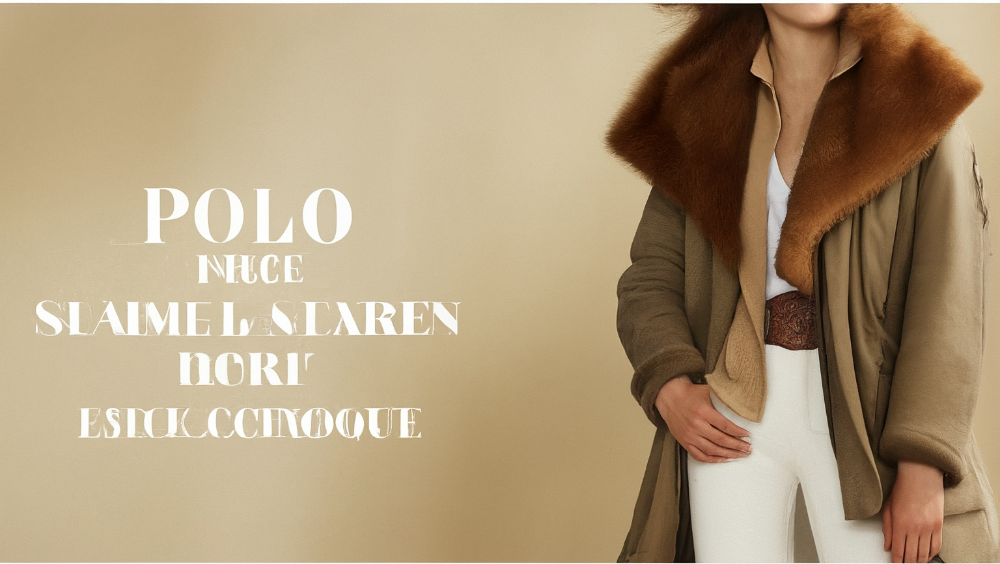

In [44]:
response = requests.post(url, headers=headers, json=request_body)

# Handle the response
if response.status_code == 200:
    response_json = response.json()
    inpainted_image_b64 = response_json['predictions'][0]['bytesBase64Encoded']
    inpainted_image_bytes = base64.b64decode(inpainted_image_b64)

    # Save the new image
    with open('inpainted_text.png', 'wb') as out_file:
        out_file.write(inpainted_image_bytes)
    print("Inpainted image saved as 'inpainted_text.png'")

else:
    print(f"Error: {response.status_code}, {response.text}")

# Display image
display(Image(inpainted_image_bytes))

### Text inpainting advice

We see the results are not promising; the text is garbled and the original images background is altered significantly. Again, this will improve with Imagen3.

One key behaviour to notice is that diffusion models are far better at generating text on an image, rather than altering it.

*Best practice*: keep a base image free of text, use it to for inpainting text from different languages / contexts etc on the base image, rather than editing one version of overlaid text to another.

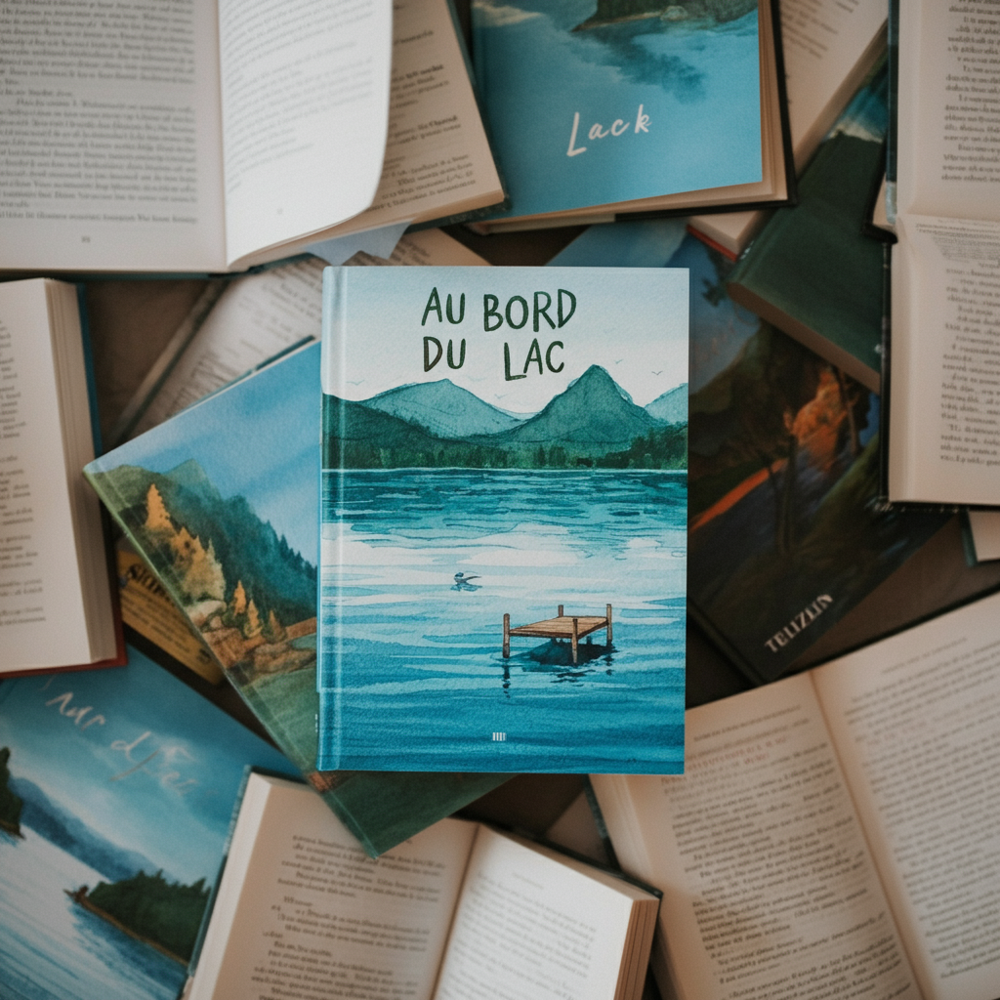

Created output image using 1564906 bytes


In [45]:
import vertexai
from vertexai.preview.vision_models import ImageGenerationModel

output_file = "generated-image.png"
prompt = "Une pile de livres vue d'en haut. Le livre le plus haut contient une illustration à l'aquarelle d'un lac. AU BORD DU LAC est écrit en lettres grasses sur le livre le plus haut"

model = ImageGenerationModel.from_pretrained("imagen-3.0-generate-001")

images = model.generate_images(
    prompt=prompt,
    number_of_images=1,
    language="fr",
    aspect_ratio="1:1",
    safety_filter_level="block_some",
    person_generation="allow_adult",
)

images[0].save(location=output_file, include_generation_parameters=False)

# Optional. View the generated image in a notebook.
images[0].show()

print(f"Created output image using {len(images[0]._image_bytes)} bytes")
# Example response:
# Created output image using 1234567 bytes

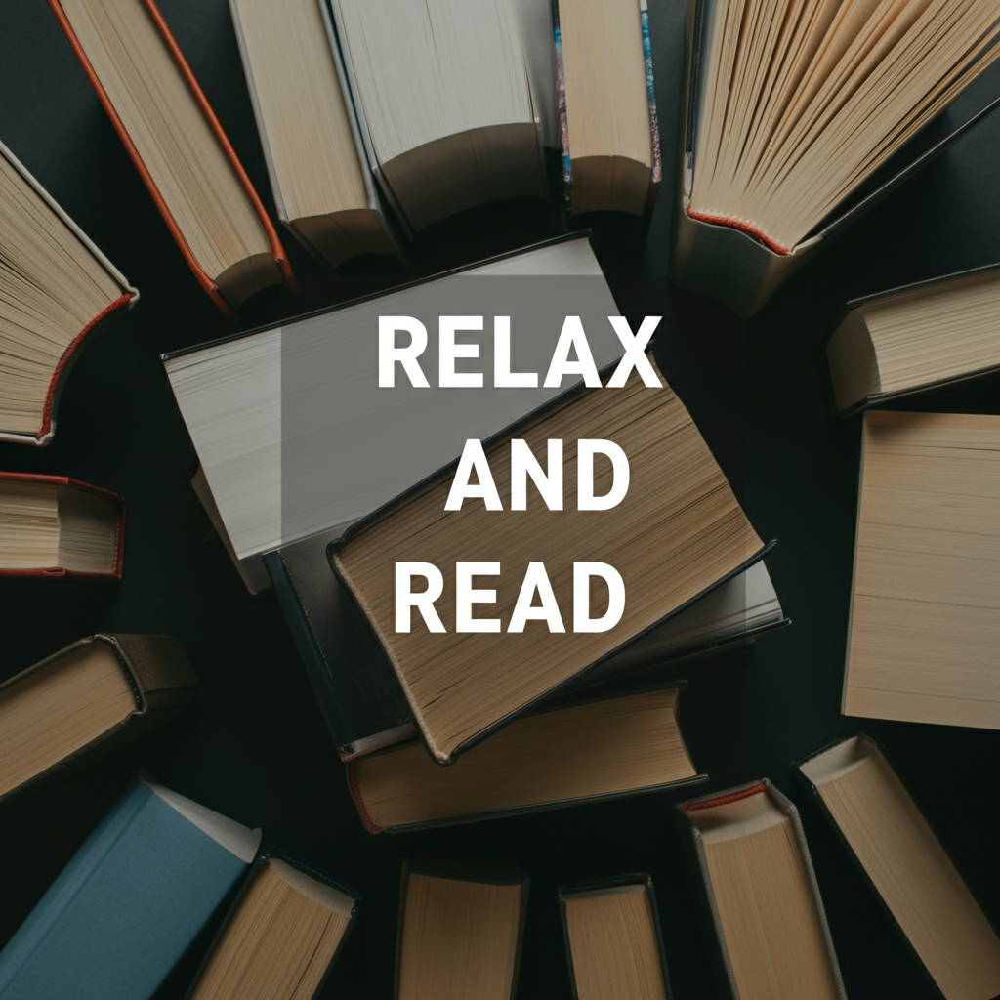

Created output image using 1417227 bytes


In [ ]:
import vertexai
from vertexai.preview.vision_models import ImageGenerationModel

output_file = "generated-image.png"
prompt = "A pile of books seen from above. RELAX AND READ is written across the image in bold letters as in a magazine cover"

images = model.generate_images(
    prompt=prompt,
    number_of_images=1,
    language="en",
    aspect_ratio="1:1",
    safety_filter_level="block_some",
    person_generation="allow_adult",
)

images[0].save(location=output_file, include_generation_parameters=False)
images[0].show()

print(f"Created output image using {len(images[0]._image_bytes)} bytes")

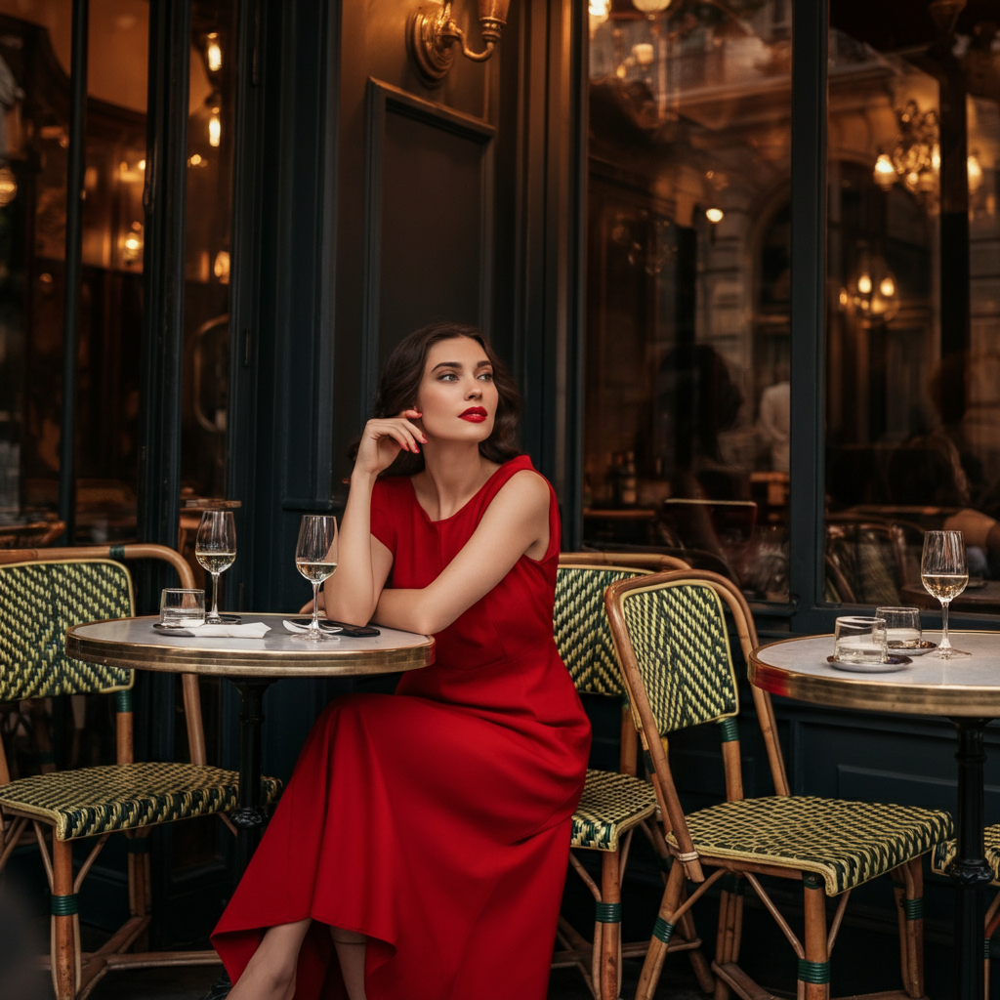

Created output image using 1496456 bytes


In [ ]:
import vertexai
from vertexai.preview.vision_models import ImageGenerationModel

output_file = "generated-image.png"
prompt = "a photorealistic 4k parisian scene: a woman in a red dress sitting in a paris cafe " # The text prompt describing what you want to see.

vertexai.init(project=PROJECT_ID, location="us-central1")

model = ImageGenerationModel.from_pretrained("imagen-3.0-generate-001")

images = model.generate_images(
    prompt=prompt,
    # Optional parameters
    number_of_images=1,
    language="en",
    # You can't use a seed value and watermark at the same time.
    # add_watermark=False,
    # seed=100,
    aspect_ratio="1:1",
    safety_filter_level="block_some",
    person_generation="allow_adult",
)

images[0].save(location=output_file, include_generation_parameters=False)

images[0].show()

print(f"Created output image using {len(images[0]._image_bytes)} bytes")

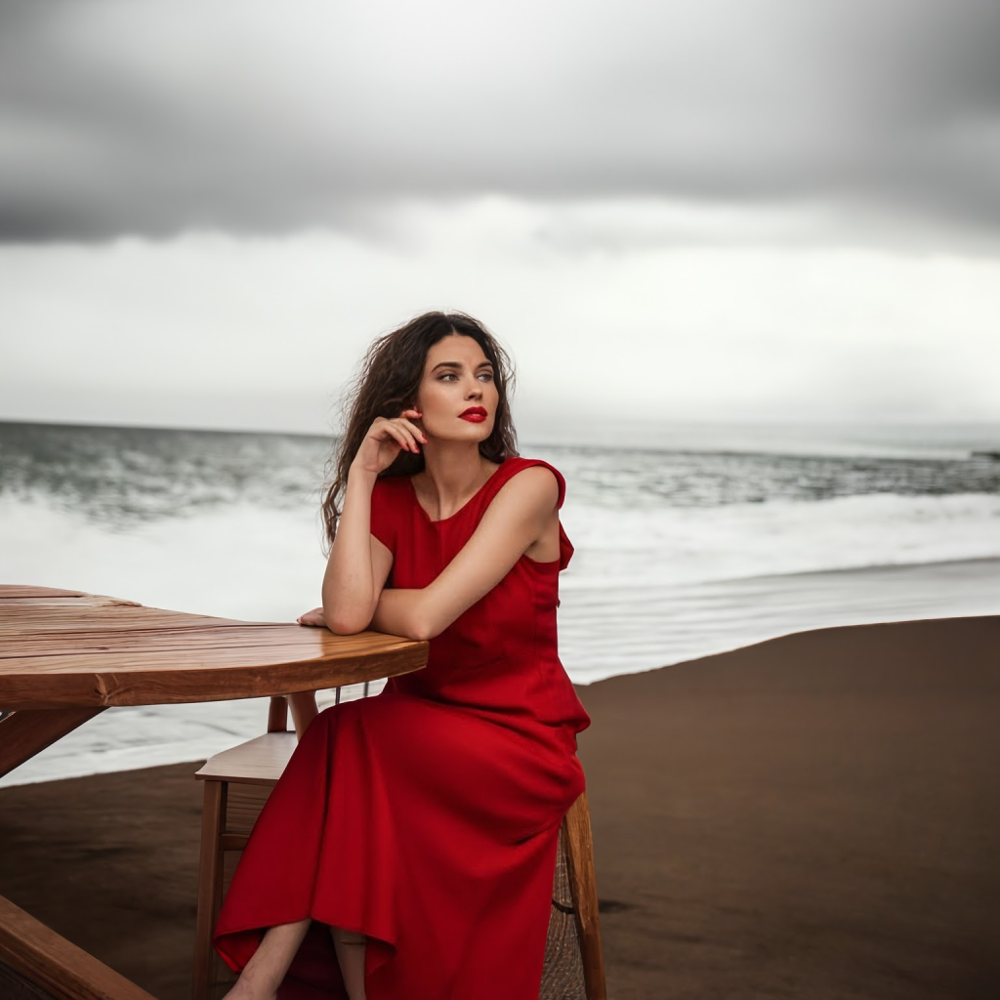

Created output image using 881718 bytes


In [ ]:
import vertexai
from vertexai.preview.vision_models import Image, ImageGenerationModel

mask_mode = "background" #"background" # 'background', 'foreground', or 'semantic'
output_file = "inpainted-image.png"
prompt = "beach" # The text prompt describing what you want to see inserted.

vertexai.init(project=PROJECT_ID, location="us-central1")

model = ImageGenerationModel.from_pretrained("imagegeneration@006")
base_img = Image.load_from_file(location='generated-image.png')

images = model.edit_image(
    base_image=base_img,
    mask_mode=mask_mode,
    prompt=prompt,
    edit_mode="inpainting-insert",
)

images[0].save(location=output_file, include_generation_parameters=False)

images[0].show()

print(f"Created output image using {len(images[0]._image_bytes)} bytes")

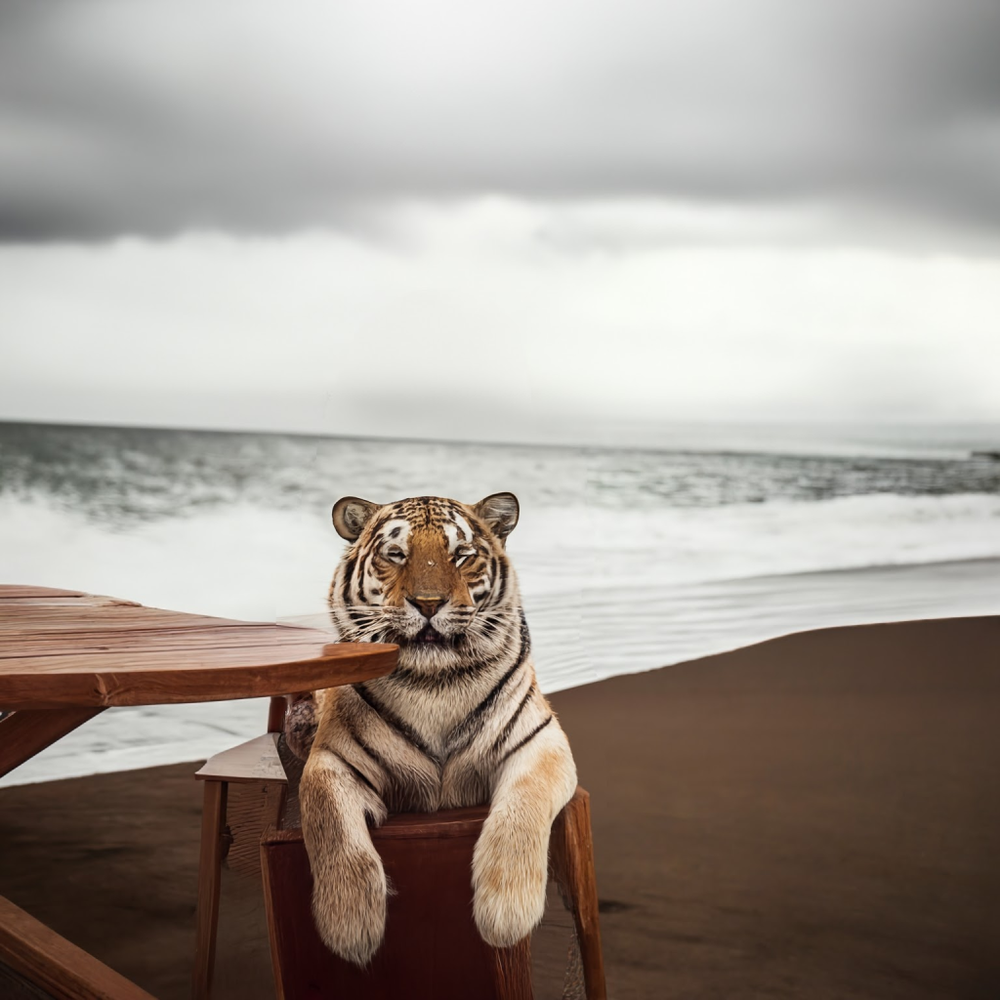

Created output image using 864959 bytes


In [ ]:
import vertexai
from vertexai.preview.vision_models import Image, ImageGenerationModel

mask_mode = "foreground" #"background" # 'background', 'foreground', or 'semantic'
output_file = "inpainted-image2.png"
prompt = "tiger" # The text prompt describing what you want to see inserted.

vertexai.init(project=PROJECT_ID, location="us-central1")

model = ImageGenerationModel.from_pretrained("imagegeneration@006")
base_img = Image.load_from_file(location='inpainted-image.png')

images = model.edit_image(
    base_image=base_img,
    mask_mode=mask_mode,
    prompt=prompt,
    edit_mode="inpainting-insert",
)

images[0].save(location=output_file, include_generation_parameters=False)

# Optional. View the edited image in a notebook.
images[0].show()

print(f"Created output image using {len(images[0]._image_bytes)} bytes")